# Без аугментаций

In [ ]:
import os
import numpy as np
import torch
from torch.utils.data import Dataset
from transformers import SegformerFeatureExtractor, SegformerForSemanticSegmentation, Trainer, TrainingArguments
from sklearn.model_selection import KFold
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import pandas as pd
import torch.nn.functional as F

# -------------------------
# 0. Настройка GPU
# -------------------------
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
os.environ["WANDB_DISABLED"] = "true"

# -------------------------
# 1. Параметры
# -------------------------
image_dir = "/content/drive/MyDrive/segmentation/images/"
mask_dir = "/content/drive/MyDrive/segmentation/annotation/"
num_classes = 5
unique_colors = [
    [0,0,0], [0,0,255], [0,255,0], [255,0,0], [255,255,255]
]
class_labels = ["фон", "синие", "зелёные", "красные", "белый"]

# -------------------------
# 2. Загрузка файлов
# -------------------------
with open("/content/drive/MyDrive/segmentation/training.txt", "r") as f:
    train_files = [line.strip() for line in f.readlines()]
with open("/content/drive/MyDrive/segmentation/testing.txt", "r") as f:
    test_files = [line.strip() for line in f.readlines()]

# -------------------------
# 3. Метрики
# -------------------------
def dice_coefficient(pred, target, class_id):
    pred_class = (pred == class_id).astype(np.int32)
    target_class = (target == class_id).astype(np.int32)
    intersection = np.sum(pred_class * target_class)
    union = np.sum(pred_class) + np.sum(target_class)
    return 2 * intersection / union if union != 0 else 1.0

def iou(pred, target, class_id):
    pred_class = (pred == class_id).astype(np.int32)
    target_class = (target == class_id).astype(np.int32)
    intersection = np.sum(pred_class * target_class)
    union = np.sum(pred_class) + np.sum(target_class) - intersection
    return intersection / union if union != 0 else 1.0

# -------------------------
# 4. Feature extractor
# -------------------------
feature_extractor = SegformerFeatureExtractor(reduce_labels=False)

# -------------------------
# 5. Предзагрузка изображений и масок
# -------------------------
def load_images_masks(file_list):
    images_mem, masks_mem = [], []
    for file_name in file_list:
        img = np.array(Image.open(os.path.join(image_dir, file_name)).convert("RGB"))
        mask = np.array(Image.open(os.path.join(mask_dir, file_name)))
        mask_class = np.zeros((mask.shape[0], mask.shape[1]), dtype=np.int64)
        for i, color in enumerate(unique_colors):
            mask_class[np.all(mask == color, axis=-1)] = i
        images_mem.append(img)
        masks_mem.append(mask_class)
    return images_mem, masks_mem

train_images_mem, train_masks_mem = load_images_masks(train_files)
test_images_mem, test_masks_mem = load_images_masks(test_files)

# -------------------------
# 6. Dataset с патчами из памяти
# -------------------------
class FundusPatchDatasetMem(Dataset):
    def __init__(self, images_mem, masks_mem, feature_extractor, patch_size=512):
        self.feature_extractor = feature_extractor
        self.patch_size = patch_size
        self.patches = []

        for img, mask in zip(images_mem, masks_mem):
            h, w, _ = img.shape
            for i in range(0, h, patch_size):
                for j in range(0, w, patch_size):
                    img_patch = img[i:i+patch_size, j:j+patch_size]
                    mask_patch = mask[i:i+patch_size, j:j+patch_size]
                    if img_patch.shape[0] == patch_size and img_patch.shape[1] == patch_size:
                        self.patches.append((img_patch, mask_patch))

    def __len__(self):
        return len(self.patches)

    def __getitem__(self, idx):
        img_patch, mask_patch = self.patches[idx]
        encoding = self.feature_extractor(images=Image.fromarray(img_patch), return_tensors="pt")
        pixel_values = encoding['pixel_values'].squeeze()
        labels = torch.tensor(mask_patch, dtype=torch.long)
        return {"pixel_values": pixel_values, "labels": labels}

/usr/local/lib/python3.12/dist-packages/transformers/models/segformer/feature_extraction_segformer.py:30: FutureWarning: The class SegformerFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use SegformerImageProcessor instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/transformers/models/segformer/feature_extraction_segformer.py:35: UserWarning: The following named arguments are not valid for `SegformerFeatureExtractor.__init__` and were ignored: 'reduce_labels'
  super().__init__(*args, **kwargs)


KeyboardInterrupt: 

In [ ]:


# -------------------------
# 7. K-Fold Cross-Validation и обучение
# -------------------------
kf = KFold(n_splits=5, shuffle=True, random_state=42)
fold_results = []

for fold, (train_idx, val_idx) in enumerate(kf.split(train_files)):
    print(f"\nFold {fold+1}")

    # создаем модель заново для каждого фолда
    model = SegformerForSemanticSegmentation.from_pretrained(
        "nvidia/segformer-b0-finetuned-ade-512-512",
        num_labels=num_classes,
        id2label={i:str(i) for i in range(num_classes)},
        label2id={str(i):i for i in range(num_classes)},
        ignore_mismatched_sizes=True
    ).to(device)

    train_fold_images = [train_images_mem[i] for i in train_idx]
    train_fold_masks = [train_masks_mem[i] for i in train_idx]
    val_fold_images = [train_images_mem[i] for i in val_idx]
    val_fold_masks = [train_masks_mem[i] for i in val_idx]

    train_ds = FundusPatchDatasetMem(train_fold_images, train_fold_masks, feature_extractor)
    val_ds = FundusPatchDatasetMem(val_fold_images, val_fold_masks, feature_extractor)

    training_args = TrainingArguments(
        output_dir=f"./segformer-fold{fold+1}",
        per_device_train_batch_size=8,
        learning_rate=5e-5,
        num_train_epochs=250,
        logging_dir=f"./logs/fold{fold+1}",
        logging_steps=25,
        save_strategy="epoch"
    )

    def compute_metrics(eval_pred):
        logits, labels = eval_pred
        if logits.shape[2:] != labels.shape[1:]:
            logits = torch.tensor(logits)
            logits = F.interpolate(logits, size=labels.shape[1:], mode="bilinear", align_corners=False)
            logits = logits.detach().cpu().numpy()
        preds = np.argmax(logits, axis=1)
        dice_per_class = [np.mean([dice_coefficient(p, l, c) for p, l in zip(preds, labels)]) for c in range(num_classes)]
        iou_per_class = [np.mean([iou(p, l, c) for p, l in zip(preds, labels)]) for c in range(num_classes)]
        return {"dice": dice_per_class, "iou": iou_per_class,
                "mean_dice": float(np.mean(dice_per_class)),
                "mean_iou": float(np.mean(iou_per_class))}

    trainer = Trainer(
        model=model,
        args=training_args,
        train_dataset=train_ds,
        eval_dataset=val_ds,
        tokenizer=feature_extractor,
        compute_metrics=compute_metrics
    )

    trainer.train()
    eval_metrics = trainer.evaluate()
    fold_results.append(eval_metrics)
    model.save_pretrained(f"./segformer-fold{fold+1}/best_model")

# -------------------------
# 8. Тестирование на GPU с предзагруженными изображениями
# -------------------------
test_metrics_per_fold = []

for fold in range(3):
    model_path = f"./segformer-fold{fold+1}/best_model"
    model = SegformerForSemanticSegmentation.from_pretrained(model_path).to(device)
    model.eval()

    dice_all, iou_all = [], []

    for img, mask_class in zip(test_images_mem, test_masks_mem):
        inputs = feature_extractor(images=img, return_tensors="pt")
        inputs = {k: v.to(device) for k, v in inputs.items()}

        with torch.no_grad():
            outputs = model(**inputs)
            logits = outputs.logits
            if logits.shape[2:] != mask_class.shape:
                logits = F.interpolate(logits, size=mask_class.shape, mode="bilinear", align_corners=False)
            pred_mask = torch.argmax(logits, dim=1).squeeze().cpu().numpy()

        dice_vals = [dice_coefficient(pred_mask, mask_class, c) for c in range(num_classes)]
        iou_vals = [iou(pred_mask, mask_class, c) for c in range(num_classes)]
        dice_all.append(dice_vals)
        iou_all.append(iou_vals)

    test_metrics_per_fold.append({
        "fold": fold+1,
        "dice": np.mean(dice_all, axis=0),
        "iou": np.mean(iou_all, axis=0)
    })

# -------------------------
# 9. Таблица метрик
# -------------------------
df_test = pd.DataFrame({
    "Fold": [m["fold"] for m in test_metrics_per_fold],
    **{f"dice_class_{i}": [m["dice"][i] for m in test_metrics_per_fold] for i in range(num_classes)},
    **{f"iou_class_{i}": [m["iou"][i] for m in test_metrics_per_fold] for i in range(num_classes)}
})
df_test["mean_dice"] = df_test[[f"dice_class_{i}" for i in range(num_classes)]].mean(axis=1)
df_test["mean_iou"] = df_test[[f"iou_class_{i}" for i in range(num_classes)]].mean(axis=1)
print(df_test)



Fold 1


Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/segformer-b0-finetuned-ade-512-512 and are newly initialized because the shapes did not match:
- decode_head.classifier.bias: found shape torch.Size([150]) in the checkpoint and torch.Size([5]) in the model instantiated
- decode_head.classifier.weight: found shape torch.Size([150, 256, 1, 1]) in the checkpoint and torch.Size([5, 256, 1, 1]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Using the `WANDB_DISABLED` environment variable is deprecated and will be removed in v5. Use the --report_to flag to control the integrations used for logging result (for instance --report_to none).
/tmp/ipython-input-610436383.py:50: FutureWarning: `tokenizer` is deprecated and will be removed in version 5.0.0 for `Trainer.__init__`. Use `processing_class` instead.
  trainer = Trainer(


Step,Training Loss
25,1.484000
50,1.272300
75,1.091500
100,0.906600
125,0.762300
150,0.653200
175,0.547300
200,0.468400
225,0.400700
250,0.351900


Trainer is attempting to log a value of "[0.9889306862602898, 0.7727576170676739, 0.4491409393158629, 0.7470894137587669, 0.7037037037037037]" of type <class 'list'> for key "eval/dice" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "[0.9781642391097491, 0.6498889681287019, 0.3447019553343879, 0.6206543164281345, 0.7037037037037037]" of type <class 'list'> for key "eval/iou" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.



Fold 2


Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/segformer-b0-finetuned-ade-512-512 and are newly initialized because the shapes did not match:
- decode_head.classifier.bias: found shape torch.Size([150]) in the checkpoint and torch.Size([5]) in the model instantiated
- decode_head.classifier.weight: found shape torch.Size([150, 256, 1, 1]) in the checkpoint and torch.Size([5, 256, 1, 1]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Using the `WANDB_DISABLED` environment variable is deprecated and will be removed in v5. Use the --report_to flag to control the integrations used for logging result (for instance --report_to none).
/tmp/ipython-input-610436383.py:50: FutureWarning: `tokenizer` is deprecated and will be removed in version 5.0.0 for `Trainer.__init__`. Use `processing_class` instead.
  trainer = Trainer(


Step,Training Loss
25,1.467700
50,1.251500
75,1.053100
100,0.885600
125,0.756500
150,0.639600
175,0.536100
200,0.456400
225,0.390900
250,0.342500


Trainer is attempting to log a value of "[0.9887817286770525, 0.7606356948052043, 0.4486314445529526, 0.7742912196547131, 0.6511566771819138]" of type <class 'list'> for key "eval/dice" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "[0.9778746954118238, 0.6445212822508817, 0.3391152813980372, 0.6449423664549452, 0.6499442003208481]" of type <class 'list'> for key "eval/iou" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.



Fold 3


Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/segformer-b0-finetuned-ade-512-512 and are newly initialized because the shapes did not match:
- decode_head.classifier.bias: found shape torch.Size([150]) in the checkpoint and torch.Size([5]) in the model instantiated
- decode_head.classifier.weight: found shape torch.Size([150, 256, 1, 1]) in the checkpoint and torch.Size([5, 256, 1, 1]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Using the `WANDB_DISABLED` environment variable is deprecated and will be removed in v5. Use the --report_to flag to control the integrations used for logging result (for instance --report_to none).
/tmp/ipython-input-610436383.py:50: FutureWarning: `tokenizer` is deprecated and will be removed in version 5.0.0 for `Trainer.__init__`. Use `processing_class` instead.
  trainer = Trainer(


Step,Training Loss
25,1.465000
50,1.239600
75,1.042700
100,0.876600
125,0.741400
150,0.624600
175,0.532700
200,0.445000
225,0.388600
250,0.326600


Trainer is attempting to log a value of "[0.9897972714028576, 0.794004580079842, 0.42658166240201145, 0.7556750007335792, 0.6313507220462217]" of type <class 'list'> for key "eval/dice" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "[0.9798532104322321, 0.6814154852009734, 0.3169763852227206, 0.6322337933476957, 0.6302147003513214]" of type <class 'list'> for key "eval/iou" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.



Fold 4


Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/segformer-b0-finetuned-ade-512-512 and are newly initialized because the shapes did not match:
- decode_head.classifier.bias: found shape torch.Size([150]) in the checkpoint and torch.Size([5]) in the model instantiated
- decode_head.classifier.weight: found shape torch.Size([150, 256, 1, 1]) in the checkpoint and torch.Size([5, 256, 1, 1]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Using the `WANDB_DISABLED` environment variable is deprecated and will be removed in v5. Use the --report_to flag to control the integrations used for logging result (for instance --report_to none).
/tmp/ipython-input-610436383.py:50: FutureWarning: `tokenizer` is deprecated and will be removed in version 5.0.0 for `Trainer.__init__`. Use `processing_class` instead.
  trainer = Trainer(


Step,Training Loss
25,1.459900
50,1.237400
75,1.036400
100,0.868700
125,0.739900
150,0.605500
175,0.527300
200,0.435500
225,0.380200
250,0.327200


Trainer is attempting to log a value of "[0.9882013763699835, 0.787316620944243, 0.42682954409664486, 0.7384839865074074, 0.6146091927458103]" of type <class 'list'> for key "eval/dice" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "[0.976769083298506, 0.6680118060623434, 0.3248805145923284, 0.6089739408135332, 0.6119238288103954]" of type <class 'list'> for key "eval/iou" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.



Fold 5


Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/segformer-b0-finetuned-ade-512-512 and are newly initialized because the shapes did not match:
- decode_head.classifier.bias: found shape torch.Size([150]) in the checkpoint and torch.Size([5]) in the model instantiated
- decode_head.classifier.weight: found shape torch.Size([150, 256, 1, 1]) in the checkpoint and torch.Size([5, 256, 1, 1]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Using the `WANDB_DISABLED` environment variable is deprecated and will be removed in v5. Use the --report_to flag to control the integrations used for logging result (for instance --report_to none).
/tmp/ipython-input-610436383.py:50: FutureWarning: `tokenizer` is deprecated and will be removed in version 5.0.0 for `Trainer.__init__`. Use `processing_class` instead.
  trainer = Trainer(


Step,Training Loss
25,1.464500
50,1.241100
75,1.047800
100,0.881600
125,0.740600
150,0.618300
175,0.520400
200,0.461100
225,0.391000
250,0.331800


Trainer is attempting to log a value of "[0.9894216913028467, 0.7891361498976116, 0.42276748261378133, 0.7665991677555398, 0.6262083472123142]" of type <class 'list'> for key "eval/dice" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "[0.9791240082247611, 0.674352473140117, 0.32643547016857116, 0.6393339293577013, 0.6243554649686871]" of type <class 'list'> for key "eval/iou" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.


   Fold  dice_class_0  dice_class_1  dice_class_2  dice_class_3  dice_class_4  \
0     1      0.975038      0.615375      0.202940      0.518651          0.25   
1     2      0.975906      0.613965      0.210658      0.523226          0.25   
2     3      0.975525      0.608297      0.171086      0.527922          0.20   

   iou_class_0  iou_class_1  iou_class_2  iou_class_3  iou_class_4  mean_dice  \
0     0.951301     0.446533     0.114781     0.352288         0.25   0.512401   
1     0.952952     0.445205     0.120677     0.356376         0.25   0.514751   
2     0.952227     0.439101     0.095589     0.360360         0.20   0.496566   

   mean_iou  
0  0.422981  
1  0.425042  
2  0.409455  


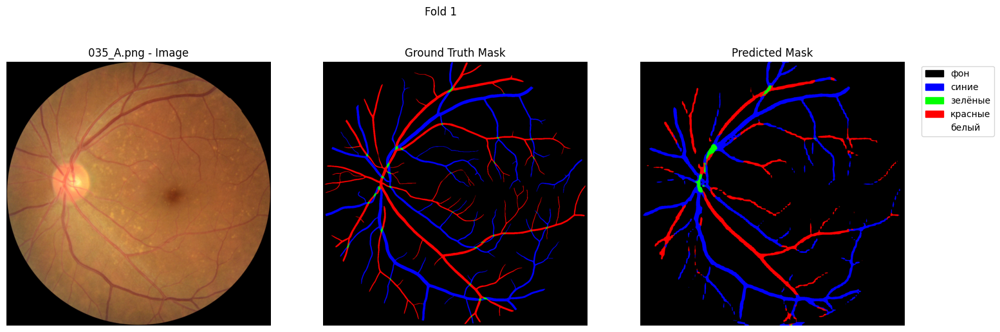

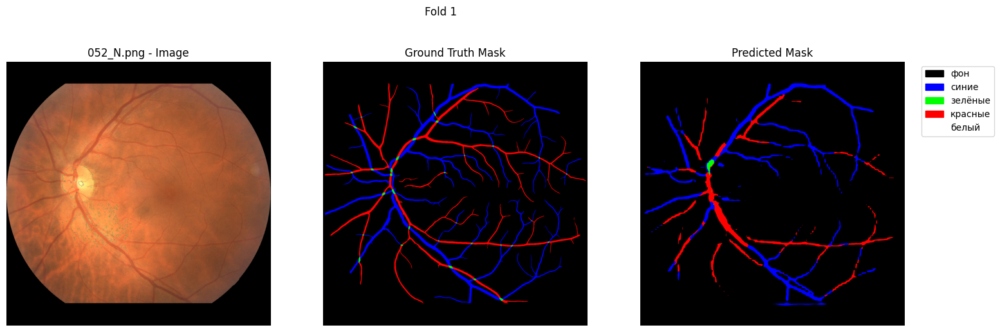

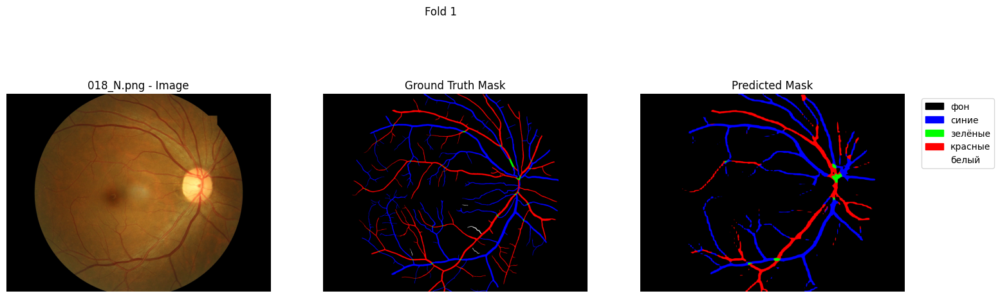

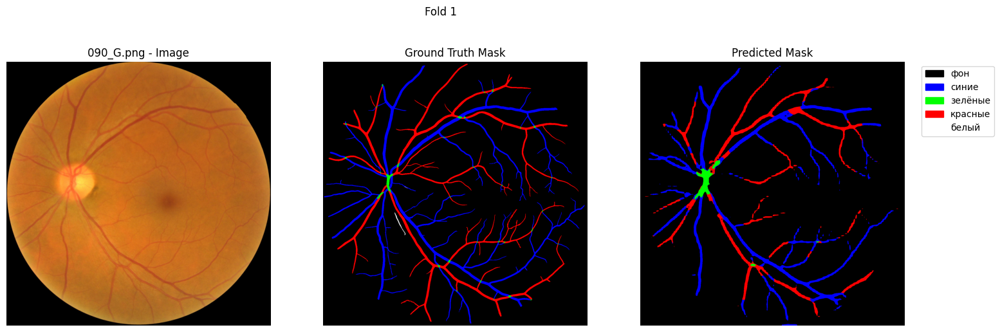

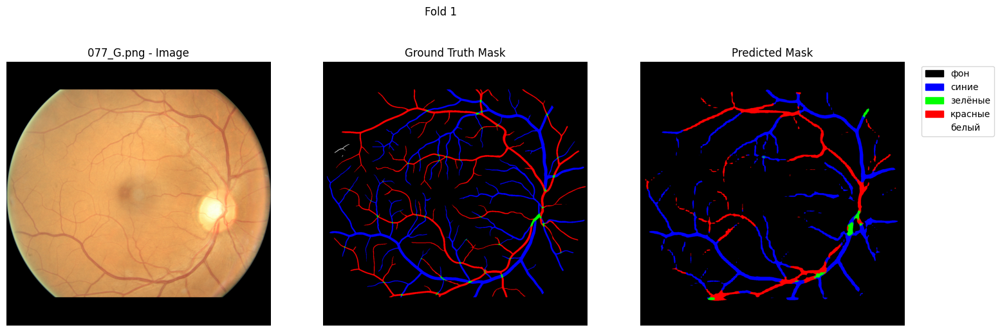

...

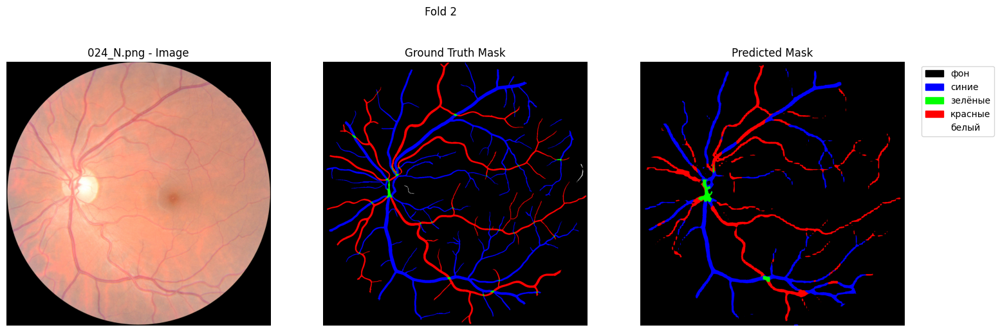

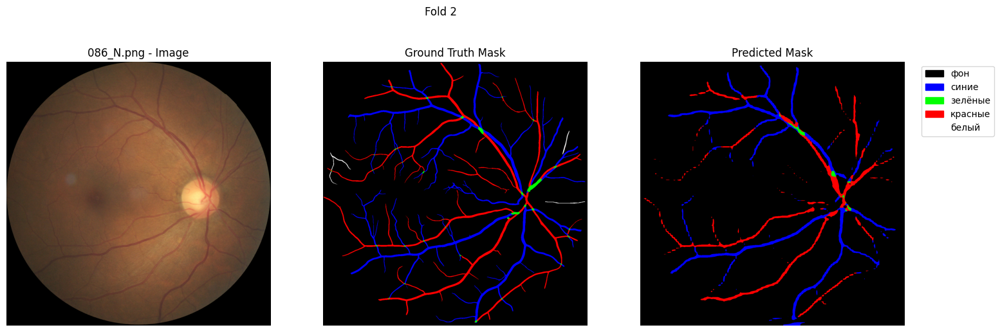

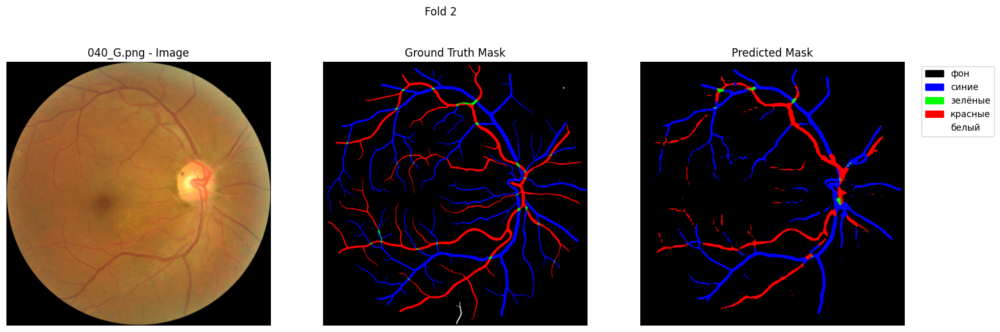

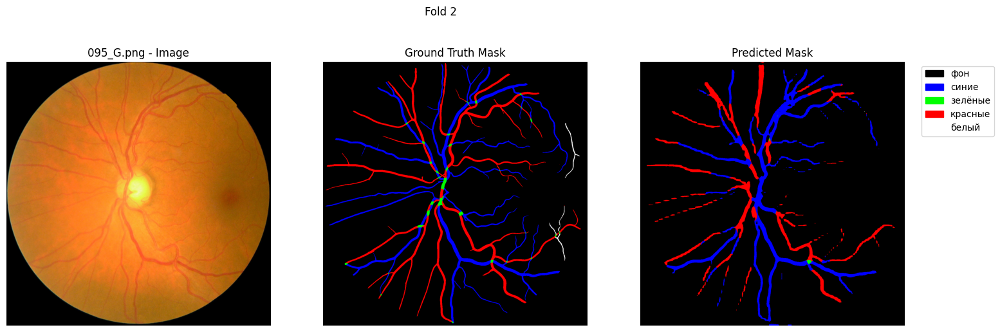

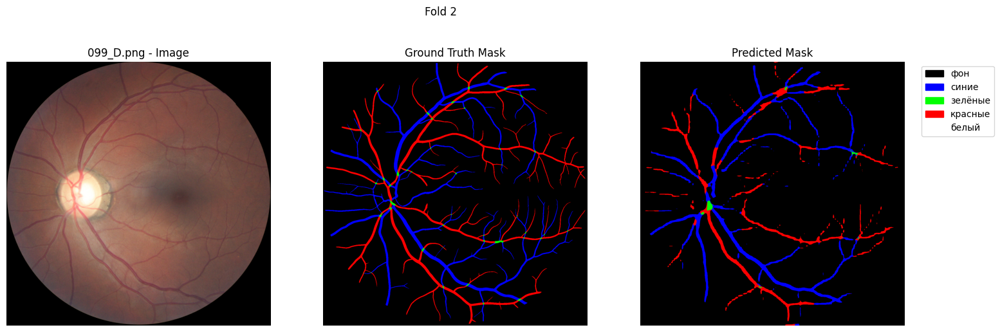

In [ ]:
import matplotlib.patches as mpatches
import torch.nn.functional as F

# Цвета классов и подписи
class_colors = np.array(unique_colors) / 255.0  # нормализуем для matplotlib
class_labels = ["фон", "синие", "зелёные", "красные", "белый"]

def mask_to_rgb(mask, colors):
    """
    Преобразует индексы классов в RGB изображение.
    mask: H x W (индексы классов)
    colors: список RGB цветов [ [R,G,B], ... ] в диапазоне 0-1
    """
    h, w = mask.shape
    rgb = np.zeros((h, w, 3), dtype=np.float32)
    for i, color in enumerate(colors):
        rgb[mask == i] = color
    return rgb

for fold in range(2):
    model_path = f"./segformer-fold{fold+1}/best_model"
    model = SegformerForSemanticSegmentation.from_pretrained(model_path)
    model.eval()

    for file_name in test_files:
        image = Image.open(os.path.join(image_dir, file_name)).convert("RGB")
        mask = np.array(Image.open(os.path.join(mask_dir, file_name)))
        mask_class = np.zeros((mask.shape[0], mask.shape[1]), dtype=np.int64)
        for i, color in enumerate(unique_colors):
            mask_class[np.all(mask == color, axis=-1)] = i

        inputs = feature_extractor(images=image, return_tensors="pt")
        with torch.no_grad():
            outputs = model(**inputs)
            logits = outputs.logits
            if logits.shape[2:] != mask_class.shape:
                logits = F.interpolate(logits, size=mask_class.shape, mode="bilinear", align_corners=False)
            pred_mask = torch.argmax(logits, dim=1).squeeze().cpu().numpy()

        # Конвертируем маски в RGB
        gt_rgb = mask_to_rgb(mask_class, class_colors)
        pred_rgb = mask_to_rgb(pred_mask, class_colors)

        # Визуализация
        fig, axes = plt.subplots(1, 3, figsize=(18, 6))
        axes[0].imshow(image)
        axes[0].set_title(f"{file_name} - Image")
        axes[0].axis("off")

        axes[1].imshow(gt_rgb)
        axes[1].set_title("Ground Truth Mask")
        axes[1].axis("off")

        axes[2].imshow(pred_rgb)
        axes[2].set_title("Predicted Mask")
        axes[2].axis("off")

        # Легенда цветов
        patches = [mpatches.Patch(color=class_colors[i], label=class_labels[i]) for i in range(num_classes)]
        axes[2].legend(handles=patches, bbox_to_anchor=(1.05, 1), loc='upper left')

        plt.suptitle(f"Fold {fold+1}")
        plt.show()


In [ ]:
import torch
import torch.nn.functional as F
import numpy as np
from scipy import stats
from transformers import SegformerForSemanticSegmentation

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
num_classes = 5  # фон, артерии, вены
alpha = 0.05    # уровень значимости для 95% доверительного интервала

def compute_metrics(pred_mask, true_mask, num_classes=num_classes):
    """Возвращает Dice, IoU и accuracy для каждой маски."""
    dice_scores = []
    iou_scores = []
    for c in range(num_classes):
        pred_c = (pred_mask == c).astype(np.int32)
        true_c = (true_mask == c).astype(np.int32)
        intersection = np.sum(pred_c * true_c)
        union = np.sum(pred_c) + np.sum(true_c)
        dice = 2 * intersection / union if union != 0 else 1.0
        iou = intersection / (np.sum(pred_c) + np.sum(true_c) - intersection) if np.sum(pred_c) + np.sum(true_c) - intersection != 0 else 1.0
        dice_scores.append(dice)
        iou_scores.append(iou)
    accuracy = np.mean(pred_mask == true_mask)
    return dice_scores, iou_scores, accuracy

def compute_confidence_interval(values, alpha=0.05):
    """Доверительный интервал среднего значения."""
    mean = np.mean(values)
    sem = stats.sem(values)
    ci = sem * stats.t.ppf((1 + (1 - alpha)) / 2, len(values)-1)
    return mean, ci

# -------------------------
# Загружаем модели и тестируем
# -------------------------
fold_metrics = []

for fold in range(5):
    model_path = f"./segformer-fold{fold+1}/best_model"
    model = SegformerForSemanticSegmentation.from_pretrained(model_path).to(device)
    model.eval()

    dice_all = []
    iou_all = []
    acc_all = []

    for img, true_mask in zip(test_images_mem, test_masks_mem):
        inputs = feature_extractor(images=img, return_tensors="pt")
        inputs = {k: v.to(device) for k,v in inputs.items()}

        with torch.no_grad():
            outputs = model(**inputs)
            logits = outputs.logits
            if logits.shape[2:] != true_mask.shape:
                logits = F.interpolate(logits, size=true_mask.shape, mode="bilinear", align_corners=False)
            pred_mask = torch.argmax(logits, dim=1).squeeze().cpu().numpy()

        dice, iou, acc = compute_metrics(pred_mask, true_mask, num_classes)
        dice_all.append(dice)
        iou_all.append(iou)
        acc_all.append(acc)

    # Считаем средние и доверительные интервалы
    dice_all = np.array(dice_all)
    iou_all = np.array(iou_all)
    acc_all = np.array(acc_all)

    dice_mean_ci = [compute_confidence_interval(dice_all[:,c], alpha) for c in range(num_classes)]
    iou_mean_ci = [compute_confidence_interval(iou_all[:,c], alpha) for c in range(num_classes)]
    acc_mean, acc_ci = compute_confidence_interval(acc_all, alpha)

    fold_metrics.append({
        "fold": fold+1,
        "dice_mean_ci": dice_mean_ci,
        "iou_mean_ci": iou_mean_ci,
        "accuracy_mean_ci": (acc_mean, acc_ci)
    })

# Выводим результаты
for fm in fold_metrics:
    print(f"Fold {fm['fold']}:")
    for c in range(num_classes):
        print(f" Class {c}: Dice={fm['dice_mean_ci'][c][0]:.4f} ± {fm['dice_mean_ci'][c][1]:.4f}, IoU={fm['iou_mean_ci'][c][0]:.4f} ± {fm['iou_mean_ci'][c][1]:.4f}")
    print(f" Accuracy={fm['accuracy_mean_ci'][0]:.4f} ± {fm['accuracy_mean_ci'][1]:.4f}\n")


Fold 1:
 Class 0: Dice=0.9750 ± 0.0010, IoU=0.9513 ± 0.0019
 Class 1: Dice=0.6154 ± 0.0257, IoU=0.4465 ± 0.0261
 Class 2: Dice=0.2029 ± 0.0350, IoU=0.1148 ± 0.0220
 Class 3: Dice=0.5187 ± 0.0286, IoU=0.3523 ± 0.0259
 Class 4: Dice=0.2500 ± 0.2079, IoU=0.2500 ± 0.2079
 Accuracy=0.9389 ± 0.0030

Fold 2:
 Class 0: Dice=0.9759 ± 0.0008, IoU=0.9530 ± 0.0016
 Class 1: Dice=0.6140 ± 0.0267, IoU=0.4452 ± 0.0269
 Class 2: Dice=0.2107 ± 0.0438, IoU=0.1207 ± 0.0278
 Class 3: Dice=0.5232 ± 0.0279, IoU=0.3564 ± 0.0253
 Class 4: Dice=0.2500 ± 0.2079, IoU=0.2500 ± 0.2079
 Accuracy=0.9417 ± 0.0025

Fold 3:
 Class 0: Dice=0.9755 ± 0.0010, IoU=0.9522 ± 0.0019
 Class 1: Dice=0.6083 ± 0.0254, IoU=0.4391 ± 0.0255
 Class 2: Dice=0.1711 ± 0.0382, IoU=0.0956 ± 0.0226
 Class 3: Dice=0.5279 ± 0.0254, IoU=0.3604 ± 0.0232
 Class 4: Dice=0.2000 ± 0.1921, IoU=0.2000 ± 0.1921
 Accuracy=0.9400 ± 0.0025

Fold 4:
 Class 0: Dice=0.9748 ± 0.0010, IoU=0.9508 ± 0.0018
 Class 1: Dice=0.6066 ± 0.0242, IoU=0.4372 ± 0.0244
 Cl

In [ ]:
# -------------------------
# Собираем все предсказания по фолдам
# -------------------------
all_dice = []
all_iou = []
all_acc = []

for fold in range(5):
    model_path = f"./segformer-fold{fold+1}/best_model"
    model = SegformerForSemanticSegmentation.from_pretrained(model_path).to(device)
    model.eval()

    for img, true_mask in zip(test_images_mem, test_masks_mem):
        inputs = feature_extractor(images=img, return_tensors="pt")
        inputs = {k: v.to(device) for k,v in inputs.items()}

        with torch.no_grad():
            outputs = model(**inputs)
            logits = outputs.logits
            if logits.shape[2:] != true_mask.shape:
                logits = F.interpolate(logits, size=true_mask.shape, mode="bilinear", align_corners=False)
            pred_mask = torch.argmax(logits, dim=1).squeeze().cpu().numpy()

        dice, iou, acc = compute_metrics(pred_mask, true_mask, num_classes)
        all_dice.append(dice)
        all_iou.append(iou)
        all_acc.append(acc)

all_dice = np.array(all_dice)
all_iou = np.array(all_iou)
all_acc = np.array(all_acc)

# -------------------------
# Функция доверительного интервала
# -------------------------
def compute_confidence_interval(values, alpha=0.05):
    mean = np.mean(values)
    sem = stats.sem(values)
    ci = sem * stats.t.ppf((1 + (1 - alpha)) / 2, len(values)-1)
    return mean, ci

# -------------------------
# Общие метрики с CI
# -------------------------
overall_dice_ci = [compute_confidence_interval(all_dice[:,c]) for c in range(num_classes)]
overall_iou_ci = [compute_confidence_interval(all_iou[:,c]) for c in range(num_classes)]
overall_acc_mean, overall_acc_ci = compute_confidence_interval(all_acc)

# -------------------------
# Вывод
# -------------------------
for c in range(num_classes):
    print(f"Class {c}: Dice = {overall_dice_ci[c][0]:.4f} ± {overall_dice_ci[c][1]:.4f}, IoU = {overall_iou_ci[c][0]:.4f} ± {overall_iou_ci[c][1]:.4f}")
print(f"Overall Accuracy = {overall_acc_mean:.4f} ± {overall_acc_ci:.4f}")


Class 0: Dice = 0.9753 ± 0.0004, IoU = 0.9519 ± 0.0008
Class 1: Dice = 0.6118 ± 0.0105, IoU = 0.4427 ± 0.0107
Class 2: Dice = 0.1937 ± 0.0165, IoU = 0.1096 ± 0.0102
Class 3: Dice = 0.5251 ± 0.0115, IoU = 0.3581 ± 0.0105
Class 4: Dice = 0.2100 ± 0.0812, IoU = 0.2100 ± 0.0812
Overall Accuracy = 0.9399 ± 0.0011


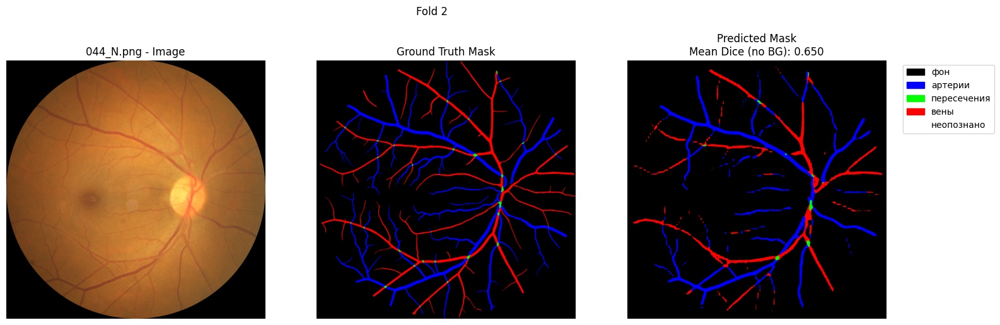

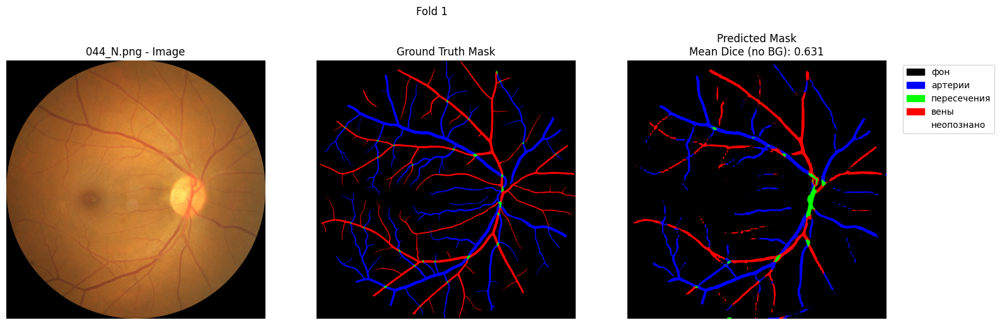

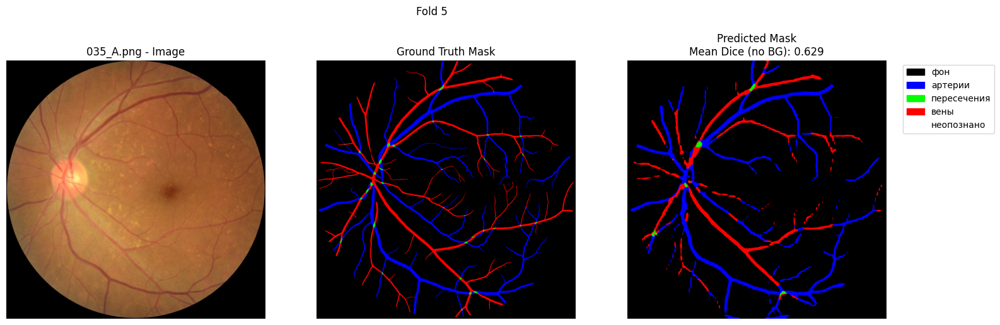

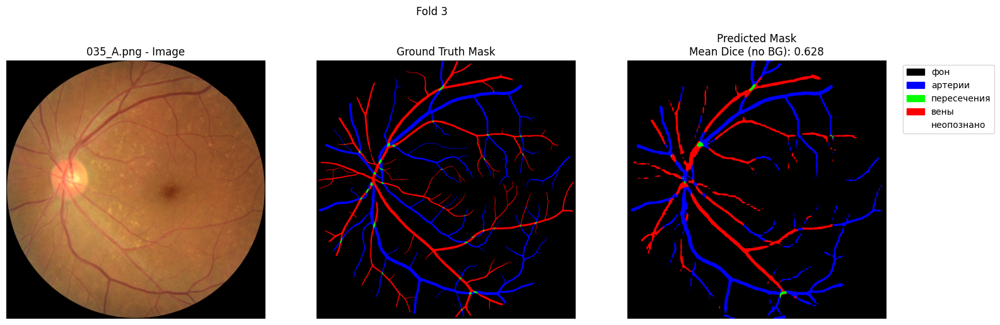

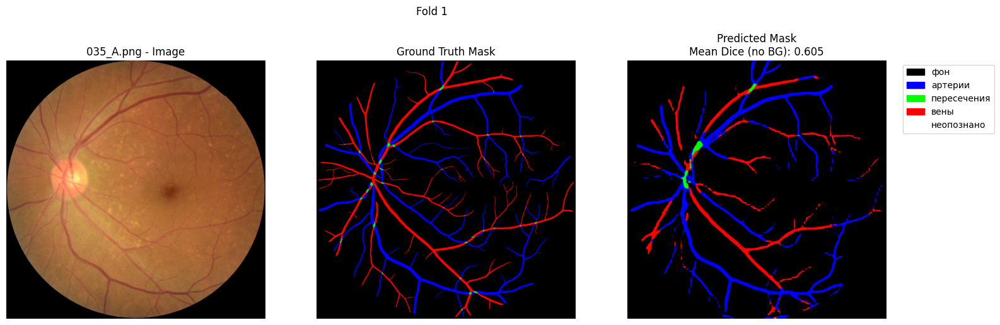

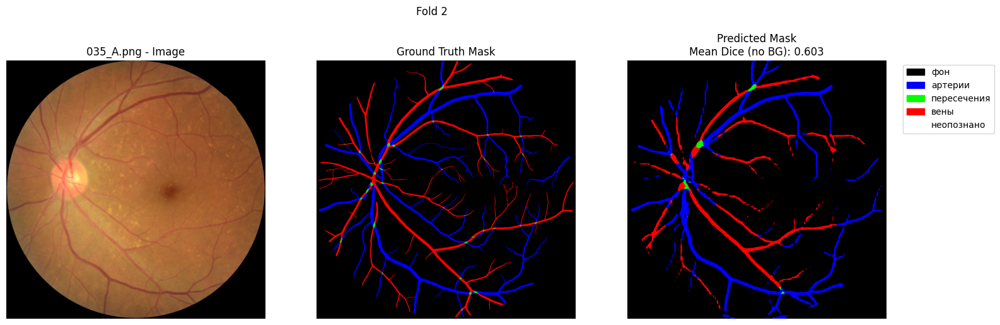

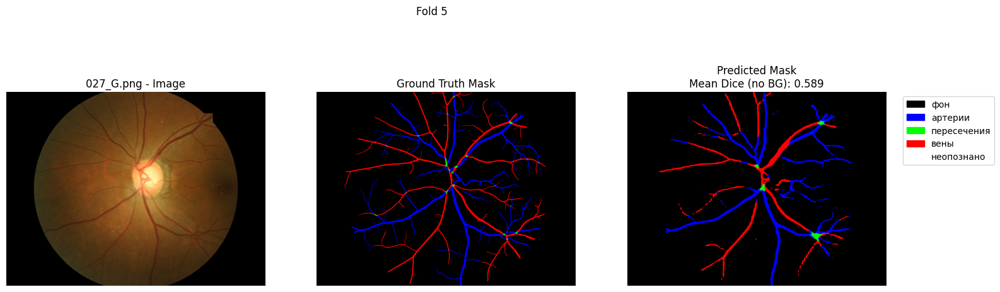

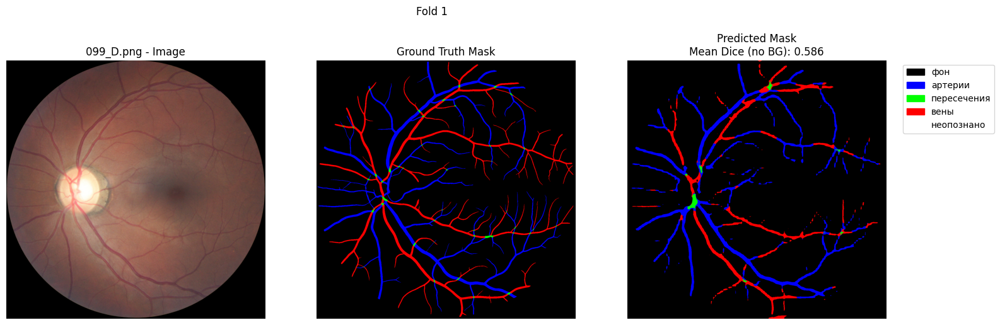

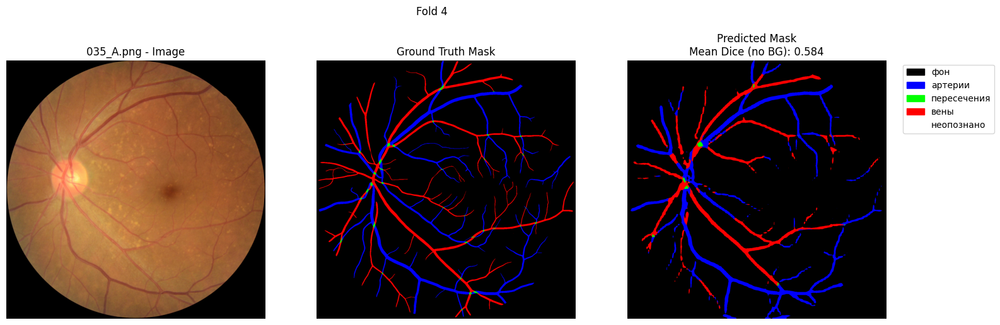

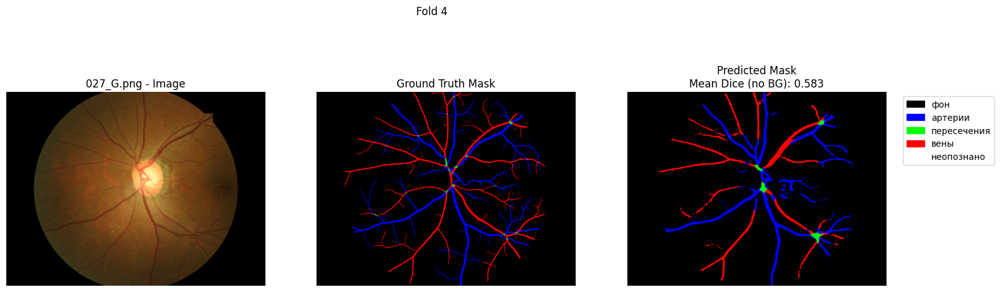

In [ ]:
import torch
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from PIL import Image

class_labels = ["фон", "артерии", "пересечения", "вены", "неопознано"]

# Функция для расчёта Dice для одного класса
def dice_coefficient_single(pred, target, class_id):
    pred_class = (pred == class_id).astype(np.int32)
    target_class = (target == class_id).astype(np.int32)
    intersection = np.sum(pred_class * target_class)
    union = np.sum(pred_class) + np.sum(target_class)
    return 2 * intersection / union if union != 0 else 1.0

# Собираем метрики для всех изображений
results = []

for fold in range(5):
    model_path = f"./segformer-fold{fold+1}/best_model"
    model = SegformerForSemanticSegmentation.from_pretrained(model_path)
    model.eval()

    for file_name in test_files:
        image = Image.open(os.path.join(image_dir, file_name)).convert("RGB")
        mask = np.array(Image.open(os.path.join(mask_dir, file_name)))
        mask_class = np.zeros((mask.shape[0], mask.shape[1]), dtype=np.int64)
        for i, color in enumerate(unique_colors):
            mask_class[np.all(mask == color, axis=-1)] = i

        inputs = feature_extractor(images=image, return_tensors="pt")
        with torch.no_grad():
            outputs = model(**inputs)
            logits = outputs.logits
            if logits.shape[2:] != mask_class.shape:
                logits = F.interpolate(logits, size=mask_class.shape, mode="bilinear", align_corners=False)
            pred_mask = torch.argmax(logits, dim=1).squeeze().cpu().numpy()

        # Рассчёт Dice для каждого класса
        dice_vals = [dice_coefficient_single(pred_mask, mask_class, c) for c in range(num_classes)]
        # Средний Dice без фона (классы 1-4)
        mean_dice_no_bg = np.mean(dice_vals[1:])

        results.append({
            "file_name": file_name,
            "fold": fold+1,
            "pred_mask": pred_mask,
            "mean_dice_no_bg": mean_dice_no_bg,
            "dice_vals": dice_vals
        })

# Сортировка по mean_dice_no_bg и берём топ-10
top_results = sorted(results, key=lambda x: x["mean_dice_no_bg"], reverse=True)[:10]

# Визуализация топ-10
for item in top_results:
    file_name = item["file_name"]
    pred_mask = item["pred_mask"]
    fold = item["fold"]

    image = Image.open(os.path.join(image_dir, file_name)).convert("RGB")
    mask = np.array(Image.open(os.path.join(mask_dir, file_name)))
    mask_class = np.zeros((mask.shape[0], mask.shape[1]), dtype=np.int64)
    for i, color in enumerate(unique_colors):
        mask_class[np.all(mask == color, axis=-1)] = i

    # Конвертируем в RGB
    gt_rgb = mask_to_rgb(mask_class, class_colors)
    pred_rgb = mask_to_rgb(pred_mask, class_colors)

    # Визуализация
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    axes[0].imshow(image)
    axes[0].set_title(f"{file_name} - Image")
    axes[0].axis("off")

    axes[1].imshow(gt_rgb)
    axes[1].set_title("Ground Truth Mask")
    axes[1].axis("off")

    axes[2].imshow(pred_rgb)
    axes[2].set_title(f"Predicted Mask\nMean Dice (no BG): {item['mean_dice_no_bg']:.3f}")
    axes[2].axis("off")

    patches = [mpatches.Patch(color=class_colors[i], label=class_labels[i]) for i in range(num_classes)]
    axes[2].legend(handles=patches, bbox_to_anchor=(1.05, 1), loc='upper left')

    plt.suptitle(f"Fold {fold}")
    plt.show()


In [ ]:
import numpy as np
import torch
import torch.nn.functional as F
from scipy import stats
from tqdm import tqdm

all_dice = []
all_iou = []

num_folds = 5  # количество сохраненных моделей
num_classes = len(unique_colors)

for fold in range(num_folds):
    model_path = f"./segformer-fold{fold+1}/best_model"
    model = SegformerForSemanticSegmentation.from_pretrained(model_path)
    model.eval()

    for file_name in tqdm(test_files, desc=f"Fold {fold+1}"):
        image = Image.open(os.path.join(image_dir, file_name)).convert("RGB")
        mask = np.array(Image.open(os.path.join(mask_dir, file_name)))
        mask_class = np.zeros((mask.shape[0], mask.shape[1]), dtype=np.int64)
        for i, color in enumerate(unique_colors):
            mask_class[np.all(mask == color, axis=-1)] = i

        inputs = feature_extractor(images=image, return_tensors="pt")
        with torch.no_grad():
            outputs = model(**inputs)
            logits = outputs.logits
            if logits.shape[2:] != mask_class.shape:
                logits = F.interpolate(logits, size=mask_class.shape, mode="bilinear", align_corners=False)
            pred_mask = torch.argmax(logits, dim=1).squeeze().cpu().numpy()

        # Dice и IoU по каждому классу
        dice_vals = []
        iou_vals = []
        for c in range(num_classes):
            pred_c = (pred_mask == c).astype(np.int32)
            target_c = (mask_class == c).astype(np.int32)
            intersection = np.sum(pred_c * target_c)
            dice = 2 * intersection / (np.sum(pred_c) + np.sum(target_c)) if (np.sum(pred_c) + np.sum(target_c)) != 0 else 1.0
            iou = intersection / (np.sum(pred_c) + np.sum(target_c) - intersection) if (np.sum(pred_c) + np.sum(target_c) - intersection) != 0 else 1.0
            dice_vals.append(dice)
            iou_vals.append(iou)

        all_dice.append(dice_vals)
        all_iou.append(iou_vals)

all_dice = np.array(all_dice)  # shape: (num_images*num_folds, num_classes)
all_iou = np.array(all_iou)

# Среднее и доверительный интервал
def mean_confidence_interval(data, confidence=0.95):
    a = np.array(data)
    n = len(a)
    m, se = np.mean(a, axis=0), stats.sem(a, axis=0)
    h = se * stats.t.ppf((1 + confidence) / 2., n-1)
    return m, h

dice_mean, dice_ci = mean_confidence_interval(all_dice)
iou_mean, iou_ci = mean_confidence_interval(all_iou)

# Вывод
for c in range(num_classes):
    print(f"Class {c}: Dice = {dice_mean[c]:.4f} ± {dice_ci[c]:.4f}, IoU = {iou_mean[c]:.4f} ± {iou_ci[c]:.4f}")

# Общие средние по всем классам
print(f"\nOverall mean Dice: {dice_mean.mean():.4f} ± {dice_ci.mean():.4f}")
print(f"Overall mean IoU: {iou_mean.mean():.4f} ± {iou_ci.mean():.4f}")


Fold 5: 100%|██████████| 20/20 [00:19<00:00,  1.05it/s]

Class 0: Dice = 0.9753 ± 0.0004, IoU = 0.9519 ± 0.0008
Class 1: Dice = 0.6118 ± 0.0105, IoU = 0.4427 ± 0.0107
Class 2: Dice = 0.1937 ± 0.0165, IoU = 0.1096 ± 0.0102
Class 3: Dice = 0.5251 ± 0.0115, IoU = 0.3581 ± 0.0105
Class 4: Dice = 0.2100 ± 0.0812, IoU = 0.2100 ± 0.0812

Overall mean Dice: 0.5032 ± 0.0240
Overall mean IoU: 0.4145 ± 0.0227


In [ ]:
import os
import shutil
import zipfile

# Папка, где сохранены модели фолдов
model_root_dir = "./"  # если модели лежат в ./segformer-fold1, ./segformer-fold2 и т.д.
num_folds = 5

# Имя ZIP-файла
zip_filename = "segformer_all_folds.zip"

# Создаём архив
with zipfile.ZipFile(zip_filename, 'w', zipfile.ZIP_DEFLATED) as zipf:
    for fold in range(1, num_folds+1):
        fold_dir = os.path.join(model_root_dir, f"segformer-fold{fold}/best_model")
        for root, dirs, files in os.walk(fold_dir):
            for file in files:
                file_path = os.path.join(root, file)
                # Сохраняем относительный путь внутри ZIP
                arcname = os.path.relpath(file_path, model_root_dir)
                zipf.write(file_path, arcname)

print(f"Все модели упакованы в {zip_filename}")


Все модели упакованы в segformer_all_folds.zip
